## PageRank

In [1]:
import data_readers 
import networkx as nx
import seaborn as sns
import matplotlib.pyplot as plt
import statistics
import math
from networkx.drawing.nx_pydot import graphviz_layout

In [2]:
# Wikispeedia Graph
w = data_readers.read_wikispeedia_graph()
print(w.nodes())

['%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Bede', 'Columba', 'D%C3%A1l_Riata', 'Great_Britain', 'Ireland', 'Isle_of_Man', 'Monarchy', 'Orkney', 'Picts', 'Scotland', 'Wales', '%C3%85land', '20th_century', 'Baltic_Sea', 'Crimean_War', 'Currency', 'Euro', 'European_Union', 'Finland', 'League_of_Nations', 'List_of_countries_by_system_of_government', 'Nationality', 'Parliamentary_system', 'Police', 'Russia', 'Stockholm', 'Sweden', 'Time_zone', 'Tourism', 'United_Kingdom', 'World_War_II', '%C3%89douard_Manet', 'Absinthe', 'Beer', 'Claude_Monet', 'Diego_Vel%C3%A1zquez', 'Edgar_Allan_Poe', 'France', 'Francisco_Goya', 'Germany', 'Impressionism', 'Italy', 'Landscape', 'Netherlands', 'Painting', 'Paris', 'Photography', 'Raphael', 'Renaissance', 'United_States_dollar', 'Washington%2C_D.C.', '%C3%89ire', 'Canada', 'English_language', 'George_VI_of_the_United_Kingdom', 'Northern_Ireland', 'Ottawa', 'Republic_of_Ireland', '%C3%93engus_I_of_the_Picts', 'Durham', 'England', 'Lion', 'Mercia', 'Viking', 'York

PageRank Dictionary: {key: value} -> {'article_title': pagerank}

In [3]:
dic = nx.pagerank(w)
print(dic)

{'%C3%81ed%C3%A1n_mac_Gabr%C3%A1in': 3.2710390395592254e-05, 'Bede': 0.00021938161316650256, 'Columba': 0.00012116881897593145, 'D%C3%A1l_Riata': 0.000105560154678038, 'Great_Britain': 0.0015061292462843427, 'Ireland': 0.001899965414851622, 'Isle_of_Man': 0.00046032088563309313, 'Monarchy': 0.0008133221072287704, 'Orkney': 0.00028994588516574057, 'Picts': 0.00019759121101826146, 'Scotland': 0.0021425304277849183, 'Wales': 0.001099763207428743, '%C3%85land': 3.2710390395592254e-05, '20th_century': 0.0023615390664036124, 'Baltic_Sea': 0.0006497932466591777, 'Crimean_War': 0.0002201292664638352, 'Currency': 0.0032371559196565525, 'Euro': 0.0012495337101871686, 'European_Union': 0.002318582455038707, 'Finland': 0.001009621435681574, 'League_of_Nations': 0.0005769703027683626, 'List_of_countries_by_system_of_government': 0.0028333266533963103, 'Nationality': 0.00022617861790487603, 'Parliamentary_system': 0.000721430277649281, 'Police': 0.0002528236285437583, 'Russia': 0.003496131617966406,

Assign pagerank as a node attribute of Wikispeedia graph

In [4]:
for node in [nodo for nodo in w.nodes()]:
    w.nodes[node]['pagerank'] = dic[node]
print(w.nodes(data=True))

[('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', {'pagerank': 3.2710390395592254e-05}), ('Bede', {'pagerank': 0.00021938161316650256}), ('Columba', {'pagerank': 0.00012116881897593145}), ('D%C3%A1l_Riata', {'pagerank': 0.000105560154678038}), ('Great_Britain', {'pagerank': 0.0015061292462843427}), ('Ireland', {'pagerank': 0.001899965414851622}), ('Isle_of_Man', {'pagerank': 0.00046032088563309313}), ('Monarchy', {'pagerank': 0.0008133221072287704}), ('Orkney', {'pagerank': 0.00028994588516574057}), ('Picts', {'pagerank': 0.00019759121101826146}), ('Scotland', {'pagerank': 0.0021425304277849183}), ('Wales', {'pagerank': 0.001099763207428743}), ('%C3%85land', {'pagerank': 3.2710390395592254e-05}), ('20th_century', {'pagerank': 0.0023615390664036124}), ('Baltic_Sea', {'pagerank': 0.0006497932466591777}), ('Crimean_War', {'pagerank': 0.0002201292664638352}), ('Currency', {'pagerank': 0.0032371559196565525}), ('Euro', {'pagerank': 0.0012495337101871686}), ('European_Union', {'pagerank': 0.002318582455

Average PageRank

In [5]:
average = sum(dic.values()) / len(dic)
print(average)

0.00021777003484320113


In [6]:
above_average = {key: value for key, value in dic.items() if value >= average}
above_average_ordered = {k: v for k, v in sorted(above_average.items(), key=lambda item: item[1], reverse=True)}
above_average_graph = nx.Graph()

In [7]:
for key, value in above_average.items():
    above_average_graph.add_node(key, pagerank=value)
print(above_average_graph.nodes)

['Bede', 'Great_Britain', 'Ireland', 'Isle_of_Man', 'Monarchy', 'Orkney', 'Scotland', 'Wales', '20th_century', 'Baltic_Sea', 'Crimean_War', 'Currency', 'Euro', 'European_Union', 'Finland', 'League_of_Nations', 'List_of_countries_by_system_of_government', 'Nationality', 'Parliamentary_system', 'Police', 'Russia', 'Stockholm', 'Sweden', 'Time_zone', 'Tourism', 'United_Kingdom', 'World_War_II', 'Beer', 'France', 'Germany', 'Italy', 'Netherlands', 'Painting', 'Paris', 'Photography', 'Raphael', 'Renaissance', 'United_States_dollar', 'Washington%2C_D.C.', 'Canada', 'English_language', 'Northern_Ireland', 'Ottawa', 'Republic_of_Ireland', 'England', 'Lion', 'Viking', 'Athens', 'Atlantic_Ocean', 'Austria', 'Belgium', 'Berlin', 'Brussels', 'Cereal', 'Christopher_Columbus', 'Cologne', 'Comet', 'Galileo_Galilei', 'Greece', 'Hamburg', 'Heraldry', 'History', 'Luxembourg', 'Maize', 'Monaco', 'Munich', 'Pope_John_Paul_II', 'Portugal', 'Rice', 'San_Marino', 'Soviet_Union', 'Spain', 'Suffrage', 'United_

In [8]:
num_elements_above_avg = len(above_average)
print("Number of elements above average")
print(num_elements_above_avg)

Number of elements above average
1134


Let's create a graph visualization with node size according to the pagerank. 

In [9]:
nodos_greater_than_average = [n for n, data in w.nodes(data=True) if 'pagerank' in data and data['pagerank'] > average]
# let's sort the nodes so that we can visualize the N elements greater than average
N = 60 # to avoid extra computing time try not to establish N higher than 80
nodes_ordered_per_pagerank = sorted(nodos_greater_than_average, key=lambda n: w.nodes[n]['pagerank'], reverse=True)[:N]
# select this nodes from the original Wikispeedia graph 
wavg = w.subgraph(nodes_ordered_per_pagerank).copy()
print(wavg)

DiGraph with 60 nodes and 1162 edges


/var/folders/tb/x8fvh4l97nl5k871xztry0mr0000gn/T/ipykernel_15222/3813012933.py:2: DeprecationWarning: nx.nx_pydot.graphviz_layout depends on the pydot package, which has known issues and is not actively maintained. Consider using nx.nx_agraph.graphviz_layout instead.

See https://github.com/networkx/networkx/issues/5723
  return graphviz_layout(net, prog="dot")


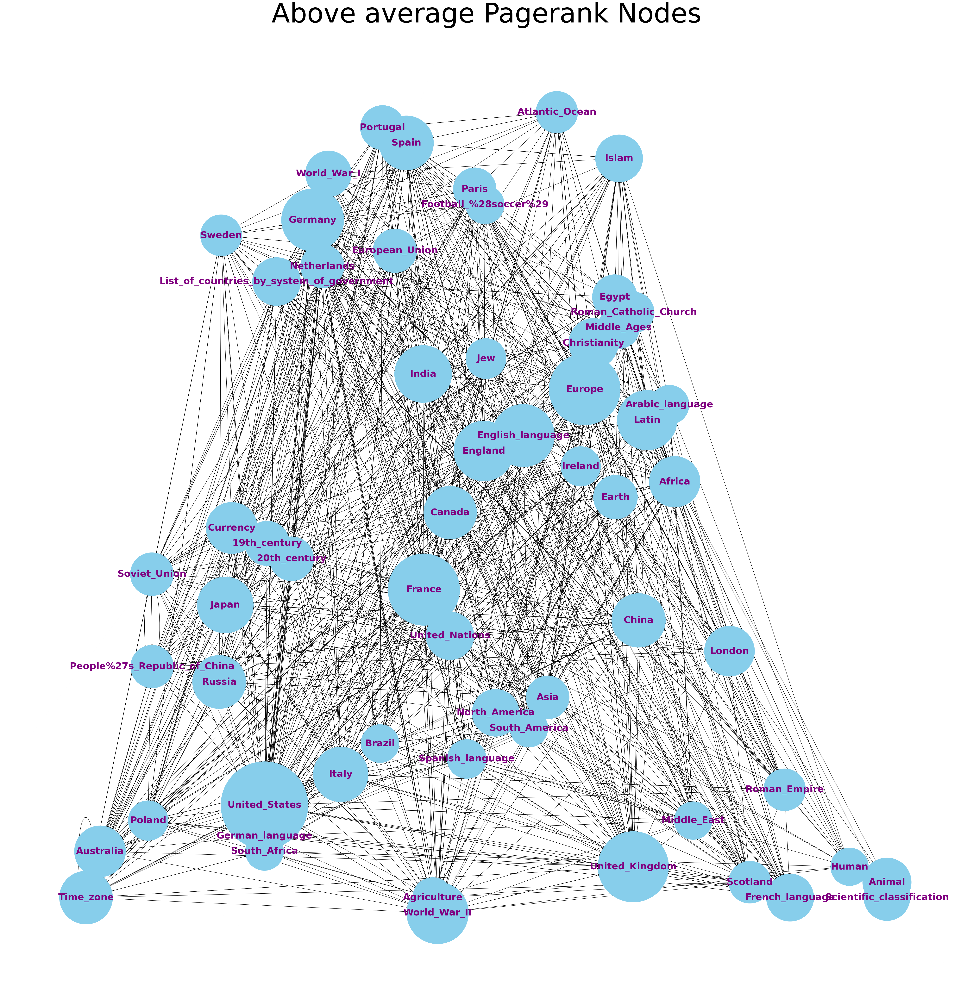

In [18]:
def hierarchical_layout(net):
	return graphviz_layout(net, prog="dot")

node_labels = {node: node for node in wavg.nodes()}

pos = hierarchical_layout(wavg)
plt.figure(figsize=(50,50))
nx.draw(wavg,pos, node_size=[(wavg.nodes[n]['pagerank'] * 10500000) for n in wavg], node_color='skyblue', font_weight='bold', with_labels=True, labels=node_labels, font_color='purple', font_size=35, linewidths=8)
plt.title('Above average Pagerank Nodes', fontsize=100)
plt.show()

When comparing this graph with the other one, we should look for differences in distribution of nodes between both graphs, and differences in size between nodes of the same graph, not differences in size of the same node between graphs.

### PageRank in descending order of the articles above the average

/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is

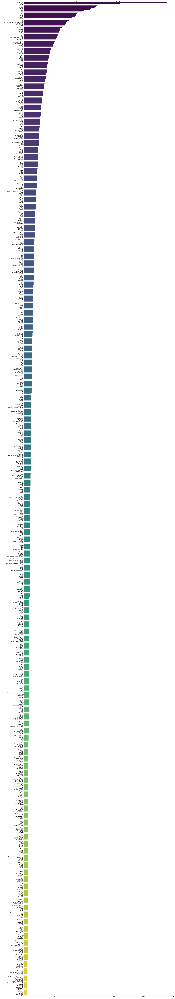

In [118]:
names = list(above_average_ordered.keys())
values = list(above_average_ordered.values())

plt.figure(figsize=(30, 200))
sns.barplot(x=values, y=names, palette='viridis')
plt.xlabel('PageRank')
plt.ylabel('Articles')
plt.title('PageRank Classification of Wikispeedia Articles above the Wikispeedia average PageRank')
plt.show()

Median PageRank

In [12]:
values = list(dic.values())

median = statistics.median(values)
print(median)

8.689532387656443e-05


In [13]:
above_median = {key: value for key, value in dic.items() if value >= median}
above_median_ordered = {k: v for k, v in sorted(above_median.items(), key=lambda item: item[1], reverse=True)}

In [14]:
num_elements_above_median = len(above_median)
print('Number of elements above average median')
print(num_elements_above_median)

Number of elements above average median
2296


In [16]:
names = list(above_median_ordered.keys())
values = list(above_median_ordered.values())

plt.figure(figsize=(30, 300))
sns.barplot(x=values, y=names, palette='viridis')
plt.xlabel('PageRank')
plt.ylabel('Articles')
plt.title('PageRank Classification of Wikispeedia Articles above the Wikispeedia median PageRank')
plt.show()

/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is

### All Articles

In [21]:
dic_ordered = {k: v for k, v in sorted(dic.items(), key=lambda item: item[1], reverse=True)}

names = list(dic_ordered.keys())
values = list(dic_ordered.values())

plt.figure(figsize=(30, 500))
sns.barplot(x=values, y=names, palette='viridis')
plt.xlabel('PageRank')
plt.ylabel('Articles')
plt.title('Wikispeedia PageRank Classification (all the articles)')
plt.show()


/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)
/Users/carolinaalbamaruganrubio/anaconda3/envs/prueba/lib/python3.9/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is

Helpers:

In [18]:
# helpers
print("Directed nodes from Bede")
print(w['Bede'])
print("First 10 edges of the list of edges")
print(list(w.edges)[0:10:None])
print("Number of nodes and edges")
print(w)

Directed nodes from Bede
{'Abbot': {}, 'Dante_Alighieri': {}, 'Durham_Cathedral': {}, 'England': {}, 'Great_Britain': {}, 'Hebrew_language': {}, 'Julius_Caesar': {}, 'Middle_Ages': {}, 'Music': {}, 'Paul_of_Tarsus': {}, 'Season': {}, 'Virgil': {}}
First 10 edges of the list of edges
[('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Bede'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Columba'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'D%C3%A1l_Riata'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Great_Britain'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Ireland'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Isle_of_Man'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Monarchy'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Orkney'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Picts'), ('%C3%81ed%C3%A1n_mac_Gabr%C3%A1in', 'Scotland')]
Number of nodes and edges
DiGraph with 4592 nodes and 119882 edges
